# Self-Driving Car Engineer Nanodegree


## Project 2: **Advanced Lane Lines** 
***
The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---

## Setup
---
### Import Packages

In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
import pickle

### Load Camera Calibrations

In [2]:
# load camera calibration data generated previously
cam_cal = pickle.load( open('./cam_cal_data.p', 'rb' ) )
mtx, dist = map(cam_cal.get, ('mtx', 'dist'))

### Load Test Images

In [3]:
# use the files from test_image folder for fine-tuning lane finding pipeline
test_images = glob.glob('./test_images/*.jpg')
num_images = len(test_images)

undistorted_images = []
image_filenames = []

for fname in test_images:
    img = mpimg.imread(fname)
    image_filenames.append(fname)

    undist = cv2.undistort(img, mtx, dist, None, mtx)
    undistorted_images.append(undist)

## Color Threshold
---
Compare the image's color channels to focus on the specific channels that do a better job of causing lane lines to stand-out.

channel test images


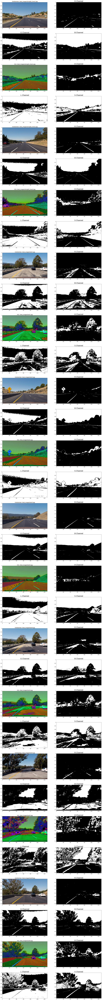

In [4]:
# applies a binary mask to help point-out which channel emphasizes the lane lines
def binaryMask(img, thresh):
    binary = np.zeros_like(img)
    binary[(img > thresh[0]) & (img <= thresh[1])] = 1
    return binary

fig, axes = plt.subplots(4*num_images, 2, figsize=(25,8 * 4*num_images)) # each image w/ 2 rows for rgb & 2 rows for hls

for i, image in enumerate(undistorted_images):
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS) # hls image
    
    # separating rgb channels
    R = image[:,:,0]
    G = image[:,:,1]
    B = image[:,:,2]
    # separating hls channels
    H = hls[:,:,0]
    L = hls[:,:,1]
    S = hls[:,:,2]

    # apply binary masks to each channel (thresholds tested to fit each channel)
    R_binary = binaryMask(R, (200, 255))
    G_binary = binaryMask(G, (150, 255))
    B_binary = binaryMask(B, (150, 225))

    H_binary = binaryMask(H, (25, 100))
    L_binary = binaryMask(L, (60, 150))
    S_binary = binaryMask(S, (60, 255))

    axes[i*4][0].imshow(image)
    axes[i*4][0].set_title('Undistorted ' + image_filenames[i], fontsize=16)

    axes[i*4][1].imshow(R_binary, cmap='gray')
    axes[i*4][1].set_title('R Channel', fontsize=24)

    axes[i*4 + 1][0].imshow(G_binary, cmap='gray')
    axes[i*4 + 1][0].set_title('G Channel', fontsize=24)

    axes[i*4 + 1][1].imshow(B_binary, cmap='gray')
    axes[i*4 + 1][1].set_title('B Channel', fontsize=24)

    axes[i*4 + 2][0].imshow(hls, cmap='gray')
    axes[i*4 + 2][0].set_title('HLS ' + image_filenames[i], fontsize=16)

    axes[i*4 + 2][1].imshow(H_binary, cmap='gray')
    axes[i*4 + 2][1].set_title('H Channel', fontsize=24)

    axes[i*4 + 3][0].imshow(L_binary, cmap='gray')
    axes[i*4 + 3][0].set_title('L Channel', fontsize=24)

    axes[i*4 + 3][1].imshow(S_binary, cmap='gray')
    axes[i*4 + 3][1].set_title('S Channel', fontsize=24)

print('channel test images')

## Sobel Threshold
---
Use Sobel thresholds to improve on problem areas shown in binary mask (ie, s-channel has issues with images that have a lot of shadows)

In [5]:
# applies Sobel x or y, then takes an absolute value and applies a threshold.
def abs_sobel_thresh(img, orient='x', thresh_min=0, thresh_max=255):
    # Take the derivative in x or y given orient = 'x' or 'y'
    sobel = None
    if(orient == 'x'):
        sobel = cv2.Sobel(img, cv2.CV_64F, 1, 0)
    else:
        sobel = cv2.Sobel(img, cv2.CV_64F, 0, 1)
    # Take the absolute value of the derivative or gradient
    abs_sobel = np.absolute(sobel)
    # Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a mask of 1's where the scaled gradient magnitude 
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel > thresh_min) & (scaled_sobel < thresh_max)] = 1
            # is > thresh_min and < thresh_max
    # Return this mask as your binary_output image
    return sxbinary

# applies Sobel x and y, then computes the magnitude of the gradient and applies a threshold
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    # Take the gradient in x and y separately
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1)
    # Calculate the magnitude 
    abs_sobel = np.sqrt(np.square(sobelx) + np.square(sobely))
    # Scale to 8-bit (0 - 255) and convert to type = np.uint8
    scale_factor = np.max(abs_sobel)/255 
    abs_sobel = (abs_sobel/scale_factor).astype(np.uint8) 
    # Create a binary mask where mag thresholds are met
    # Return this mask as your binary_output image
    binary_output = np.zeros_like(abs_sobel)
    binary_output[(abs_sobel >= mag_thresh[0]) & (abs_sobel <= mag_thresh[1])] = 1
    return binary_output

# applies Sobel x and y, then computes the direction of the gradient and applies a threshold.
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Take the gradient in x and y separately
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the x and y gradients
    abs_sobelx = np.sqrt(np.square(sobelx))
    abs_sobely = np.sqrt(np.square(sobely))
    # Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    grad_dir = np.arctan2(abs_sobely, abs_sobelx)
    # Create a binary mask where direction thresholds are metbinary_output =  np.zeros_like(absgraddir)
    binary_output = np.zeros_like(grad_dir)
    binary_output[(grad_dir >= thresh[0]) & (grad_dir <= thresh[1])] = 1
    # Return this mask as your binary_output image
    return binary_output

Combine the sobel threshold on test images S-channel

sobel tests


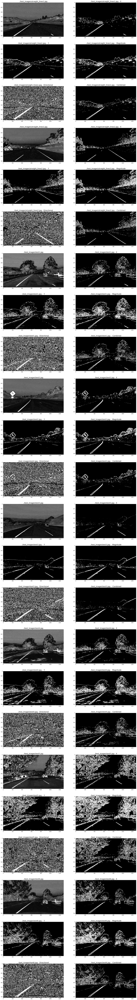

In [6]:
# row for binary mask, gradient threshold, and final row to show final combined next to original 
fig, axes = plt.subplots(num_images * 3, 2, figsize=(25,8 * num_images * 3))

for i, image in enumerate(undistorted_images):
    fname = image_filenames[i]
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS) # hls image
    
    # s channel
    s_channel = hls[:,:,2]
    
    grad_x = abs_sobel_thresh(s_channel, orient='x', thresh_min=15, thresh_max=150)
    grad_y = abs_sobel_thresh(s_channel, orient='y', thresh_min=15, thresh_max=150)
    grad_xy = np.zeros_like(grad_x)
    grad_xy[(grad_x == 1) & (grad_y == 1)] = 1
    
    mag_binary = mag_thresh(s_channel, sobel_kernel=9, mag_thresh=(15, 150))
    dir_binary = dir_threshold(s_channel, sobel_kernel=15, thresh=(0.7, 1.3))
    
    combined = np.zeros_like(mag_binary)
    combined[(grad_xy == 1) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    
    axes[i*3][0].imshow(s_channel, cmap='gray')
    axes[i*3][0].set_title(fname, fontsize=18)

    axes[i*3][1].imshow(grad_x, cmap='gray')
    axes[i*3][1].set_title(fname + ' - X', fontsize=18)

    axes[i*3+1][0].imshow(grad_y, cmap='gray')
    axes[i*3+1][0].set_title(fname + ' -  Y', fontsize=18)

    axes[i*3+1][1].imshow(mag_binary, cmap='gray')
    axes[i*3+1][1].set_title(fname + ' -  Magnitude', fontsize=18)

    axes[i*3+2][0].imshow(dir_binary, cmap='gray')
    axes[i*3+2][0].set_title(fname + ' - Directional', fontsize=18)

    axes[i*3+2][1].imshow(combined, cmap='gray')
    axes[i*3+2][1].set_title(fname + ' -  Combined', fontsize=18)

print('sobel tests')

## Perspective Tranform
---
Define points for focusing warp perspective

In [7]:
# load example image with straight lines to use as test
img = mpimg.imread('./test_images/straight_lines1.jpg') # rgb image

# undistort image
undist = cv2.undistort(img, mtx, dist, None, mtx)

# points to use for box
lr_offset = 180
tb_offset = 15
img_size = (undist.shape[1], undist.shape[0])

#source points for straight lane line
src = np.float32([[562, 465], [720, 465],
                         [1130, 700], [185, 700]])
    
dst = np.float32([[lr_offset, tb_offset],[img_size[0]-lr_offset, tb_offset],
                         [img_size[0]-lr_offset, img_size[1]-tb_offset], [lr_offset, img_size[1]-tb_offset]])

Warp image to get top down view to better calculate lane curvature

perspective transform example


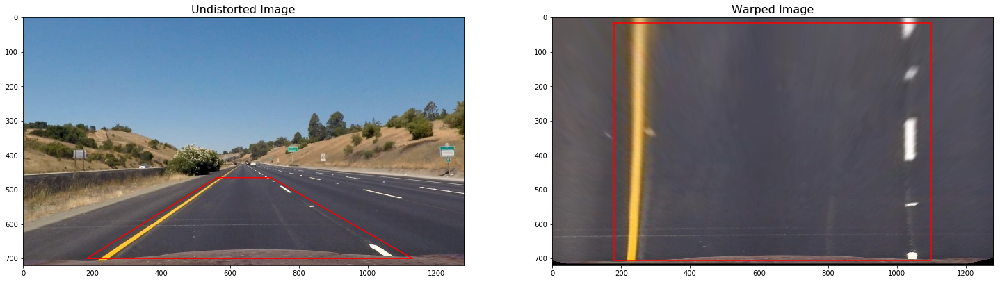

In [8]:
# unwarped image
M = cv2.getPerspectiveTransform(src, dst)
Minv = cv2.getPerspectiveTransform(dst, src)
warped = cv2.warpPerspective(undist, M, img_size)

# separating x, y axis to draw on undistorted image
src_x = src.T[0]
src_x = np.append(src_x, src_x[0])
src_y = src.T[1]
src_y = np.append(src_y, src_y[0])

dst_x = dst.T[0]
dst_x = np.append(dst_x, dst_x[0])
dst_y = dst.T[1]
dst_y = np.append(dst_y, dst_y[0])

fig, ax = plt.subplots(1, 2, figsize=(25,8))

ax[0].imshow(undist)
ax[0].plot(src_x, src_y, color='#FF0000')
ax[0].set_title('Undistorted Image', fontsize=16)

ax[1].imshow(warped)
ax[1].plot(dst_x, dst_y, color='#FF0000')
ax[1].set_title('Warped Image', fontsize=16)

# save warp data for later use
pickle.dump({'M': M, 'Minv': Minv}, open('./warp_data.p', 'wb'))

print('perspective transform example')

Apply previously used sobel algorithms to isolate lines

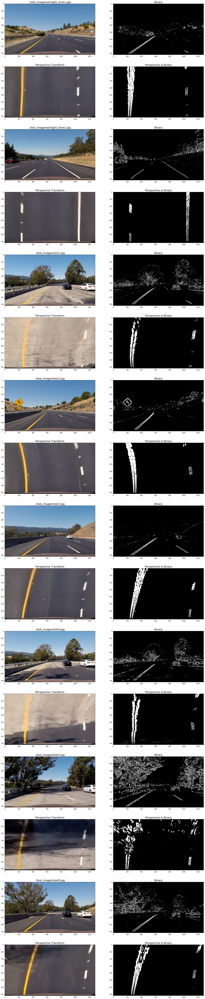

In [9]:
def apply_combined_sobel(img):
    
    grad_x = abs_sobel_thresh(img, orient='x', thresh_min=15, thresh_max=150)
    grad_y = abs_sobel_thresh(img, orient='y', thresh_min=15, thresh_max=150)
    grad_xy = np.zeros_like(grad_x)
    grad_xy[(grad_x == 1) & (grad_y == 1)] = 1
    
    mag_binary = mag_thresh(img, sobel_kernel=9, mag_thresh=(15, 150))
    dir_binary = dir_threshold(img, sobel_kernel=15, thresh=(0.7, 1.3))
    
    combined = np.zeros_like(mag_binary)
    combined[(grad_xy == 1) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    
    return grad_xy

fig, axes = plt.subplots(len(undistorted_images)*2, 2, figsize=(25,8 * 2 * len(undistorted_images)))

# run through test images
for i, undist in enumerate(undistorted_images):
    fname = image_filenames[i]
    # warp perspective
    img_size = (undist.shape[1], undist.shape[0])
    
    #convert to hls and isolate s-channel
    hls = cv2.cvtColor(undist, cv2.COLOR_RGB2HLS) # hls image
    s_channel = hls[:,:,2]
    # apply sobel to create binary mask
    binary = apply_combined_sobel(s_channel)
    
    warped = cv2.warpPerspective(undist, M, img_size)
    warped_binary = cv2.warpPerspective(binary, M, img_size)
    
    axes[i*2][0].imshow(undist)
    axes[i*2][0].set_title(fname, fontsize='18')
    
    axes[i*2][1].imshow(binary, cmap='gray')
    axes[i*2][1].set_title('Binary', fontsize='18')
    
    axes[i*2+1][0].imshow(warped)
    axes[i*2+1][0].set_title('Perspective Transform', fontsize='18')
    
    axes[i*2+1][1].imshow(warped_binary, cmap='gray')
    axes[i*2+1][1].set_title('Perspective & Binary', fontsize='18')
    
    mpimg.imsave('./output_images/tranformed_binary_' + fname.split('/')[1].split('\\')[1], warped_binary, cmap='gray')

## Plot & Analyze Lane Lines
---
Analyze the lane lines for plotting pixels and using data to find lines and their curvature

In [10]:
def findLaneLine(binary_warped, nwindows=9, margin=100,minpix=50):

    # grab bottom half of the image to get first part of lines
    bottom_half = binary_warped[binary_warped.shape[0]//2:,:]
    # create historgram from sum across image pixels vertically
    histogram = np.sum(bottom_half, axis=0)

    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram for respective lanes
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    
    # height of windows
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # map all x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base# Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        ### TO-DO: Find the four below boundaries of the window ###
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        
        ### TO-DO: Identify the nonzero pixels in x and y within the window ###
        good_left_inds = ((nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high) &
                (nonzeroy >= win_y_low) & (nonzeroy < win_y_high)).nonzero()[0]
        good_right_inds = ((nonzerox >= win_xright_low) & (nonzerox < win_xright_high) &
                (nonzeroy >= win_y_low) & (nonzeroy < win_y_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        ### TO-DO: If you found > minpix pixels, recenter next window ###
        ### (`right` or `leftx_current`) on their mean position ###
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    return leftx, lefty, rightx, righty, out_img

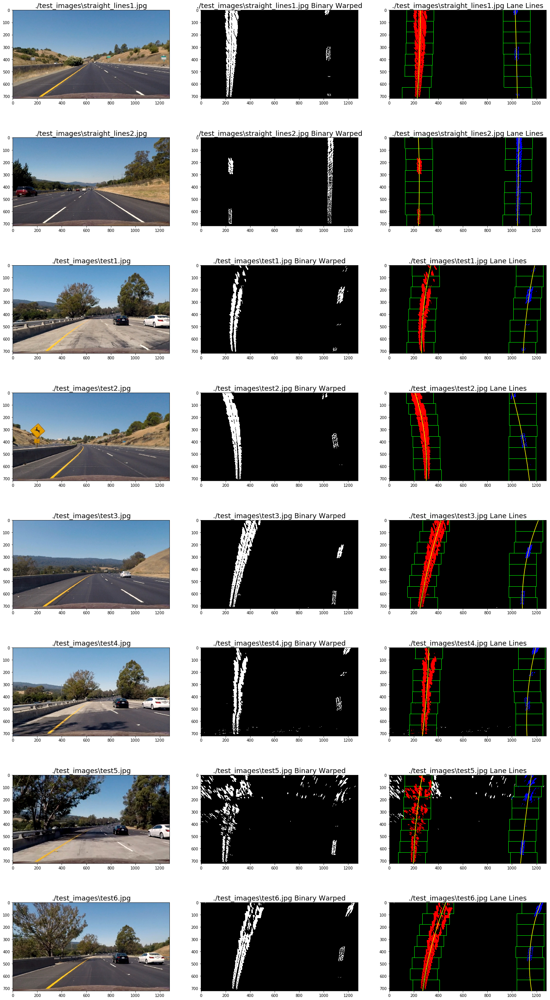

In [11]:
def plotLaneLines(ax, leftx, lefty, rightx, righty, out_img):
    # fit a second order polynomial
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # y space incompassess full top to bottom range image
    ploty = np.linspace(0, img.shape[0]-1, img.shape[0] )
    # separate x-values for left and right lanes to plot on top of image
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # color code the pixels in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]
    
    axes[i][2].imshow(out_img)
    axes[i][2].plot(left_fitx, ploty, color='yellow')
    axes[i][2].plot(right_fitx, ploty, color='yellow')
    axes[i][2].set_title(fname + ' Lane Lines', fontsize='18')

fig, axes = plt.subplots(len(undistorted_images), 3, figsize=(25,6 * len(undistorted_images)))

# iterate through undistorted images for testing
for i, undist in enumerate(undistorted_images):
    fname = image_filenames[i]
    
    #mask s-channel
    hls = cv2.cvtColor(undist, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    # apply sobel to create binary mask
    binary = apply_combined_sobel(s_channel)
    # warp image
    warped = cv2.warpPerspective(binary, M, img_size)

    # HYPERPARAMETERS
    # number of sliding windows
    nwindows = 8
    # Set the width of the windows +/- margin
    margin = 110
    # Set minimum number of pixels found to recenter window
    minpix = 60

    leftx, lefty, rightx, righty, out_img = findLaneLine(warped, nwindows, margin, minpix)
    
    axes[i][0].imshow(undist)
    axes[i][0].set_title(fname, fontsize='18')
    
    axes[i][1].imshow(warped, cmap='gray')
    axes[i][1].set_title(fname + ' Binary Warped', fontsize='18')
    
    plotLaneLines(axes[i][2], leftx, lefty, rightx, righty, out_img)

## Calculate Curvature
---
Calculate the curvature of the lane lines plotted.

In [12]:
def measureCurvatureAndCarPosition(leftx, lefty, rightx, righty, img, ym_per_pix=30/720, xm_per_pix=3.7/700):    
    # fit a second order polynomial in world space
    left_fit = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)

    # y space incompassess full top to bottom range image
    ploty = np.linspace(0, img.shape[0]-1, img.shape[0])
    
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)

    # Calculation of curvature radius in world space
    left_curverad = ((1 + (2*left_fit[0]*y_eval*ym_per_pix + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    right_curverad = ((1 + (2*right_fit[0]*y_eval*ym_per_pix + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
    
    #locate center of car based on center of image with respect to center of lane lines
    y_max = img.shape[0]*ym_per_pix
    x_max = img.shape[1]*xm_per_pix
    car_center = x_max/2
    
    left_lane_mid = left_fit[0]*y_eval**2 + left_fit[1]*y_eval + left_fit[2]
    right_lane_mid = right_fit[0]*y_eval**2 + right_fit[1]*y_eval + right_fit[2]
    lane_center = (left_lane_mid + right_lane_mid)/2
    car_from_center = lane_center - car_center
    
    return left_curverad, right_curverad, car_from_center

In [19]:
# hyperparameters for conversions in x and y from pixels space to meters
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

print("Estimated radius of curvature for test images (in meters):")

# iterate through undistorted images for testing
for i, undist in enumerate(undistorted_images):
    fname = image_filenames[i]
    
    #mask s-channel
    hls = cv2.cvtColor(undist, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    # apply sobel to create binary mask
    binary = apply_combined_sobel(s_channel)
    # warp image
    warped = cv2.warpPerspective(binary, M, img_size)

    # HYPERPARAMETERS
    # number of sliding windows
    nwindows = 8
    # Set the width of the windows +/- margin
    margin = 110
    # Set minimum number of pixels found to recenter window
    minpix = 60

    leftx, lefty, rightx, righty, out_img = findLaneLine(warped, nwindows, margin, minpix)
    
    left_curverad, right_curverad, car_from_center = measureCurvatureAndCarPosition(leftx, lefty, rightx, righty, out_img, ym_per_pix, xm_per_pix)
    
    print("\t" + fname + ":\n\t\t" + str((left_curverad, right_curverad)) + '  | distance from center: ' + str(car_from_center))

Estimated radius of curvature for test images (in meters):
	./test_images\straight_lines1.jpg:
		(3192.6408573903714, 14422.527430926391)  | distance from center: -47.84636892848302
	./test_images\straight_lines2.jpg:
		(2851.447553481866, 51914.76334727781)  | distance from center: -41.78352837571276
	./test_images\test1.jpg:
		(943.6510424516778, 1434.9939383030824)  | distance from center: 207.47814380038383
	./test_images\test2.jpg:
		(634.8937678589656, 1602.1573992968551)  | distance from center: -257.87658684841654
	./test_images\test3.jpg:
		(1581.9759540087787, 548.7897975431317)  | distance from center: 285.7443987932336
	./test_images\test4.jpg:
		(2310.7256308709398, 798.8843057930442)  | distance from center: 94.1737962840968
	./test_images\test5.jpg:
		(1674.2693614166017, 4690.375437927208)  | distance from center: 90.63622837737694
	./test_images\test6.jpg:
		(942.6288886888043, 444.8550958485617)  | distance from center: 394.49582221536514


Create methods for drawing lanes onto images

In [23]:
def drawLane(img, leftx, lefty, rightx, righty, Minv):
    # fit a second order polynomial
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # y space incompassess full top to bottom range image
    ploty = np.linspace(0, img.shape[0]-1, img.shape[0] )
    # separate x-values for left and right lanes to plot on top of image
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    #get y range for mapping x values
    yMax = img.shape[0]
    ploty = np.linspace(0, yMax - 1, yMax)
    
    # Calculate points.
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    #create blank image to draw lanes
    warped_lanes = np.zeros_like(img).astype(np.uint8)
    
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))
    
    # Draw the lane onto the warped blank image
    cv2.fillPoly(warped_lanes, np.int_([pts]), (0,255, 0))
    
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    unwarped = cv2.warpPerspective(warped_lanes, Minv, (img.shape[1], img.shape[0])) 
    return cv2.addWeighted(img, 1, unwarped, 0.3, 0)

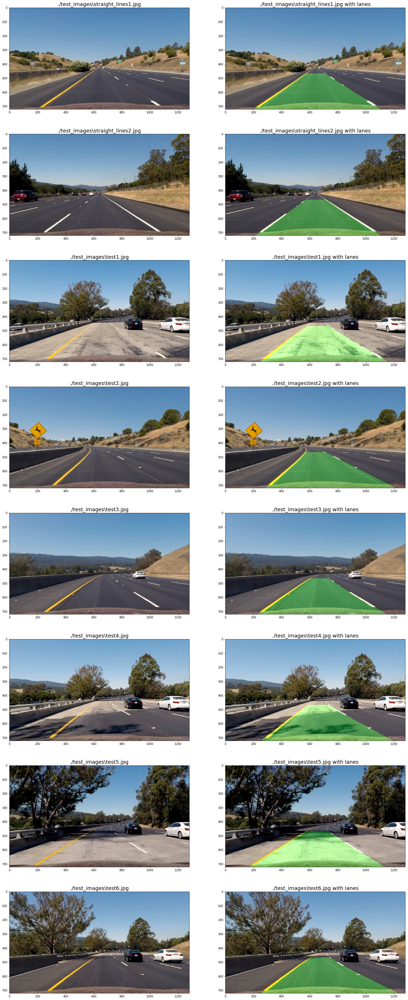

In [24]:
fig, axes = plt.subplots(len(undistorted_images), 2, figsize=(25,8 * len(undistorted_images)))

# run through test images
for i, undist in enumerate(undistorted_images):
    fname = image_filenames[i]
    # warp perspective
    img_size = (undist.shape[1], undist.shape[0])
    
    #convert to hls and isolate s-channel
    hls = cv2.cvtColor(undist, cv2.COLOR_RGB2HLS) # hls image
    s_channel = hls[:,:,2]
    # apply sobel to create binary mask
    binary = apply_combined_sobel(s_channel)
    
    warped = cv2.warpPerspective(undist, M, img_size)
    binary_warped = cv2.warpPerspective(binary, M, img_size)
    
    leftx, lefty, rightx, righty, out_img = findLaneLine(binary_warped, nwindows=8, margin=110,minpix=60)
    
    lane_img = drawLane(undist, leftx, lefty, rightx, righty, Minv)
    
    axes[i][0].imshow(undist)
    axes[i][0].set_title(fname, fontsize=18)
    
    axes[i][1].imshow(lane_img)
    axes[i][1].set_title(fname + ' with lanes', fontsize=18)